In [128]:
import cv2
import time
import os
import numpy as np
import natsort
import matplotlib.pyplot as plt
from pathlib import Path
import glob
import faiss
try:
    import cPickle as pickle
except ImportError:  # Python 3.x
    import pickle

In [129]:
!pip3 list | grep faiss

faiss-gpu                     1.7.2


# SIFT + BF Matching
    - Extract SIFT Descriptors
    - Brute-Force Matching with two images
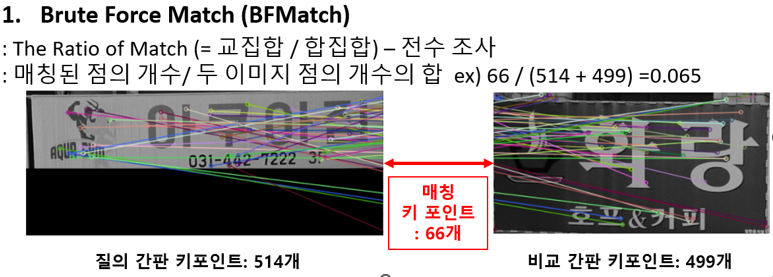

## 1. Input : Image Path

In [5]:
#### Path
!rm -rf ./panorama_test/panorama_crop/q_crop_val/.ipynb_checkpoints/
!rm -rf ./panorama_test/panorama_crop/db_crop_val/.ipynb_checkpoints/
###### panoramo db_root
pnorm_db_root = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/db_crop_val/'

pnorm_db_dic = {}
for db in os.listdir(pnorm_db_root):
    
    if db != 'labels':
        db_root = pnorm_db_root + db + '/'
        db_path_list = natsort.natsorted([db_root + db_name for db_name in os.listdir(db_root) if 'jpg' in db_name or 'png' in db_name])
        pnorm_db_dic[db] = db_path_list
        
pnorm_q_root = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/q_crop_val/'

pnorm_q_dic = {}
for q in os.listdir(pnorm_q_root):
    
    if q != 'labels':
        q_root = pnorm_q_root + q + '/'
        q_path_list =natsort.natsorted( [q_root + q_name for q_name in os.listdir(q_root) if 'jpg' in q_name or 'png' in q_name])
        pnorm_q_dic[q] = q_path_list

### 1.1 Feature Descriptor
    1. SIFT
    2. RootSIFT

In [119]:
# SIFT
def sift_extractor(file_path):
    '''
    Description: extract \emph{sift} feature from given image
    Input: file_path - image path
    Output: des - a list of descriptors of all the keypoint from the image
    '''
    img = cv2.imread(file_path)
    gray= cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create() # 1000
    _,des = sift.detectAndCompute(gray,None) 

    return des

In [120]:
# RootSIFT
# import the necessary packages

class RootSIFT:
	def __init__(self, max_kps):
		# initialize the SIFT feature extractor
		self.max_kps = max_kps
		self.extractor = cv2.SIFT_create(self.max_kps)
	def compute(self, image, kps, eps=1e-7):
		# compute SIFT descriptors
		kps, descs = self.extractor.detectAndCompute(image,kps)
		# if there are no keypoints or descriptors, return an empty tuple
		if len(kps) == 0:
			return ([], None)
		# apply the Hellinger kernel by first L1-normalizing and taking the
		# square-root(L2-noramlized)
		descs /= (descs.sum(axis=1, keepdims=True) + eps)
		descs = np.sqrt(descs)
		#descs /= (np.linalg.norm(descs, axis=1, ord=2) + eps)
		# return a tuple of the keypoints and descriptors
		return (kps, descs)

In [121]:
# RootSIFT
# input: file_path
def rootsift_extractor(file_path):
    '''
    Description: extract \emph{sift} feature from given image
    Input: file_path - image path
    Output: des - a list of descriptors of all the keypoint from the image
    '''
    img = cv2.imread(file_path)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    rs = RootSIFT(99999) #full
    _, des = rs.compute(gray, None) 

    return des

### 1.2 Retrieval : ret_kp
    - SIFT BF Matching Retrieval

In [176]:
#input : path_list

def ret_kp(q_path_list, db_path_list, panorama_id, dic_save_path, txt_save_path, matcher='bf', metric="l2", method='rootsift', \
           val = "union", cross_check=True, img_format='jpg'):
    
    '''
    panorama_id : ID of panorama, specific location identified number including query and database
    metric : str, how to compare with two key points, ["l1" : "NORM_L1", "l2" : "NORM_L2"]
    matcher : str, how to match key point with query and database, ['bf' : 'BF', 'flann' : 'FlannBased']
    method : str, how to extract feature from image, ['rootsift', 'sift']
    val : str, how to calculate match score, ['union' : intersection / union, 'min' : intersection / min set]
    cross_check : bool, whether both description are all matched
    img_format : str, image format, [jpg, png, ...]
    '''
    
    #info
    print(f"{matcher}-{metric}-{method}")
    
    # check time
    start = time.perf_counter()
    
    # config
    matcher_dic = {'bf' : 'BF', 'flann' : 'FlannBased'}
    metric_dic = {"l1" : "NORM_L1", "l2" : "NORM_L2"}
    if matcher == 'bf':
        match = eval(f"cv2.BFMatcher(cv2.{metric_dic[metric]}, crossCheck={cross_check})") #cross_check 양쪽 des 매칭된 kp만 반영 ↔ 속도
    else: #flann
        FLANN_INDEX_KDTREE = 1
        index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
        search_params = dict(checks=50)
        match = eval(f"cv2.FlannBasedMatcher({index_params}, {search_params})")
        
    # # time per query
    # time_list = []
    result_dic = {}
    
    for q_idx, q_path in enumerate(q_path_list):

        #time per query start
        q_t_b = time.perf_counter()

        # print(f"q : {q_idx+1}/{len(q_path_list)}") ####
        
        #extract feature
        try:
            des_q = eval(f"{method}_extractor('{q_path}')") 
        except:
            # print(q_path)
            print("extract q feature error")
    
        #q -> db match list
        match_list = []

        for db_idx, db_path in enumerate(db_path_list):

            # print(f"db img {idx_db}/{len(db_file_list)}")

            #extract feature
            #match btw query and db
            try:
                des_db = eval(f"{method}_extractor('{db_path}')")
                matches = match.match(des_q, des_db)

                #####eval#####
                # 매칭된 개수
                inter = len(matches)
                if val == 'union':
                    # 교집합/ 합집합    
                    union = (len(des_q)+len(des_db))
                    match_score = inter / union
                else :  # 'min'
                    # 교집합/ 작은 집합 수
                    min_set = min(len(des_q), len(des_db))
                    match_score = inter / min_set

                match_list.append((db_idx, match_score))
            except:
                # print(db_path)
                print("extract db feature error")

            #time per query check
            # print(f"search time:{time.perf_counter() - q_t_b}") ####
            # time_list.append(time.perf_counter() - q_t_b)

        #query db matching dic
        result_dic[q_idx] = match_list
    
    #check time
    print("ret_time", time.perf_counter()-start)
    
    #save result dict
    os.makedirs(dic_save_path + f"/{matcher}/{metric}/{method}/", exist_ok=True)
    with open(dic_save_path + f"/{matcher}/{metric}/{method}/dic_{panorama_id}" + ".p", 'wb') as fp: #rs : RootSIFT
        pickle.dump(result_dic, fp, protocol=pickle.HIGHEST_PROTOCOL)

    # save top1 pair .txt
    os.makedirs(txt_save_path + f"/{matcher}/{metric}/{method}/", exist_ok=True)
    out_file = txt_save_path + f"/{matcher}/{metric}/{method}/pair_{panorama_id}" + ".txt"
    f_out = open(out_file, 'w')

    for q_idx in list(result_dic.keys()):
        
        #query_name
        query_name = Path(q_path_list[q_idx]).stem
        
        # sort by match score(intersect/union)
        rank_list = sorted(result_dic[q_idx], key = lambda x: -x[1])

        for (db_idx, _)  in rank_list:
            
            #db_name
            db_name = Path(db_path_list[db_idx]).stem

            f_out.write(query_name + f'.{img_format},' + db_name + f'.{img_format}' + '\n')
            f_out.flush()
                    
    f_out.close()

##### exec ######
        
dic_save_path = "/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/result_dic/kp/"
txt_save_path = "/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/pair_txt/kp/"    

# check time
start = time.perf_counter()

for i, q in enumerate(pnorm_q_dic.keys()):
    
    #process
    print(f"ID : {i}/{len(pnorm_q_dic)}")
    
    for metric in ["l1"]:
        for matcher in ['bf']:
            for method in ['rootsift']:

                try: # query ID == db ID
                    # exec
                    ret_kp(q_path_list=pnorm_q_dic[q], db_path_list=pnorm_db_dic[q], panorama_id=q, dic_save_path=dic_save_path, \
                           txt_save_path=txt_save_path, matcher=matcher, metric=metric, method=method, img_format='jpg')

                except: # if query ID not in db ID
                    print("ID error")
                    print(f"query ID : {q}")
                    
#check time
total_time = time.perf_counter()-start
print("total_time", total_time, "q_time", total_time/len(pnorm_q_dic))

# panorama 1개
# sift
# q_time 0.4935340724181032

# vit384
# q_time 0.69

# panorama 97개
# total_time 48.366339096974116

ID : 0/97
bf-l1-rootsift
ret_time 2.1435032300651073
ID : 1/97
bf-l1-rootsift
ret_time 0.2536935689859092
ID : 2/97
bf-l1-rootsift
ret_time 0.12286532705184072
ID : 3/97
bf-l1-rootsift
ret_time 0.04943916795309633
ID : 4/97
bf-l1-rootsift
ret_time 0.20427140197716653
ID : 5/97
bf-l1-rootsift
ret_time 0.44805222493596375
ID : 6/97
bf-l1-rootsift
ret_time 0.024441908113658428
ID : 7/97
bf-l1-rootsift
ret_time 0.4393978730076924
ID : 8/97
bf-l1-rootsift
ret_time 0.6960555939003825
ID : 9/97
bf-l1-rootsift
ret_time 0.40664242091588676
ID : 10/97
bf-l1-rootsift
ret_time 0.6105401139939204
ID : 11/97
bf-l1-rootsift
extract db feature error
extract db feature error
extract db feature error
extract db feature error
extract db feature error
extract db feature error
extract db feature error
extract db feature error
extract db feature error
ret_time 0.43717084894888103
ID : 12/97
bf-l1-rootsift
ret_time 0.013930978020653129
ID : 13/97
bf-l1-rootsift
ret_time 0.05695293692406267
ID : 14/97
bf-l1-r

### - utils
    - cp
    - rename

In [138]:
# vlad cp pair.txt
!cp /home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/pair_txt/vlad/cs/*.txt /home/Signboard_Retrieval/roadview_384_crop/match_score/sift_best_pair

# kp cp pair.txt
# !cp /home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/pair_txt/kp/bf/l2/rootsift/*.txt /home/Signboard_Retrieval/roadview_384_crop/match_score/sift_best_pair

In [234]:
# rename pair.txt
import shutil
import os

#rename folder
rename_dir = '/home/Signboard_Retrieval/roadview_384_crop/match_score/sift-kp_best_pair/'
fname_list = os.listdir(rename_dir)

for fname in fname_list:
    new_fname = fname[:-8] + 'sift-kp.txt'
    shutil.move(f'{rename_dir}/{fname}', \
                f'{rename_dir}/{new_fname}')

In [230]:
# rename pair.txt
import shutil
import os

#rename folder
rename_dir = '/home/Signboard_Retrieval/roadview_384_crop/match_score/vit384_best_pair/'
fname_list = os.listdir(rename_dir)

for fname in fname_list:
    
    new_fname = fname[:-7] + 'vit384.txt'
    shutil.move(f'{rename_dir}/{fname}', \
                f'{rename_dir}/{new_fname}')

### 1.3 Merge : merge_topk
    - Merge SIFT& VIT 
        1. SIFT+KNN-Matching Score(K=2) : match_score
    - Sort& Filter by topk

In [8]:
# input : path
def match_score(q_crop_path, db_crop_path, score_thres):
    # Trace how to get the match score
    q_img = cv2.imread(q_crop_path) #query
    q_img_gray = cv2.cvtColor(q_img, cv2.COLOR_BGR2GRAY)
    q_img_flip0 = cv2.flip(q_img_gray, 0) #상하 반전
    q_img_flip1 = cv2.flip(q_img_gray, 1) #좌우 반전

    db_img = cv2.imread(db_crop_path)
    db_img_gray = cv2.cvtColor(db_img, cv2.COLOR_BGR2GRAY)
    
    # SIFT feature
    sift = cv2.SIFT_create()
    kp_q, des_q = sift.detectAndCompute(q_img_gray,None)
    kp_q0, des_q0 = sift.detectAndCompute(q_img_flip0,None)
    kp_q1, des_q1 = sift.detectAndCompute(q_img_flip1,None)
    kp_db, des_db = sift.detectAndCompute(db_img_gray,None)
    
    # KNN(K=2) Match including flipped img
    bf = cv2.BFMatcher(cv2.NORM_L2) #전수조사, Normalized L2

    match_num_list = []
    
    des_num_list = [] #여러 가지 des_q 중 가장 개수가 많은 걸 선택
    for des_q in [des_q, des_q0, des_q1]:
        try:
            des_num_list.append(len(des_q)) #각각의 개수를 넣어주기
            matches = bf.knnMatch(des_q, des_db, k=2) #KNN-Matching(K=2) for match_score

            # ratio_threshold
            good_without_list = []

            try:
                for m,n in matches:

                    if m.distance < score_thres*n.distance: #2nd 최근접 이웃 거리의 특정 비율 보다 작은 1st 최근접 이웃만!

                        good_without_list.append(m)

            except: # K=2의 최근접이 없다면, 그냥 score 0점! (보수적)
                print("there are no 2 knn match!")

            #get match_num
            match_num_list.append(len(good_without_list))

            score = max(match_num_list)
            # score = max( [ match_num/(max(des_num_list)+len(des_db)) for match_num in match_num_list] ) #normalized ratio -->> 안된다!
            # print(max(match_num_list), max(des_num_list), len(des_db) )
            # if len(des_db) < max(match_num_list):
            #     print(q_crop_path, db_crop_path)
            
        except: #extract kp error!
            print("key point error")
            score = 0
         
    return score

In [228]:
#input : path
def merge_topk(result_path, q_crop_dir, db_crop_dir, panorama_id, topk, algo='max', val=False):
    
    '''
    topk: int, the number of matching candidates
    match_weight: float, threshold of whether matched or not
    result_path: str, folder path saving results, './match_score/'
    method: str, what you want to use, ['vit', 'sift', 'vit_sift', 'sift_vit']
    algo: str, matching algorithm, ['max', 'erase']
        - 'max' : matching pairs for maximizing score
        - 'erase' : matching pairs removing top1 prediction sequentially.
    val: bool, whether evaluate or not
    '''
    
    #merge
    method =  ['vit', 'sift'] #['vit', 'sift', 'ocr']
    merge_dict = {}
    
    for m in method:
        try:
            with open(f"{result_path}/{m}_best_pair/pair_{panorama_id}_{m}.txt", "r") as f:
                for line in f.readlines():
                    data = line.strip().split(',')
                    img1 = data[0].split('.')[0]
                    img2 = data[1].split('.')[0]
                    score = match_score(q_crop_path=q_crop_dir+f"/{panorama_id}/{data[0]}",\
                                        db_crop_path=db_crop_dir+f"/{panorama_id}/{data[1]}",\
                                        score_thres=score_thres)

                    if img1+'-'+img2 not in merge_dict: #3가지 방법에서 특정 q_db pair가 중복된다면, 점수를 합산!
                        merge_dict[img1+'-'+img2] = score
                    else:
                        merge_dict[img1+'-'+img2] += score
        except:
            print(f"method {m} error")
            
    #change form
    result_dict = {}
    
    for key in merge_dict:
        imgs = key.split('-')
        q = imgs[0]
        db = imgs[1]
        del imgs
        score = merge_dict[key]
        
        #특정 query에 대해, 모든 ref를 list에 모아주기
        if q not in result_dict: #이 query가 처음 나왔을 때
            result_dict[q] = [(db, score)]
        else: #query가 중복될 경우
            db_list = result_dict[q]
            db_list.append((db, score))
            result_dict[q] = db_list
            
    #Matching Algorithm
    if algo == 'max':
    
        result_topk = {}

        for q in result_dict.keys():

            #use match score sorted
            topk_list = sorted(result_dict[q], key=lambda x: -x[1])[:topk] #(db, score)
            result_topk[q] = topk_list
            
    else: #algo == 'erase'
        result_topk = {}
        erase_list = []

        for q in result_dict.keys():

            #erase top1 matching
            erased_list = [(db, score) for (db, score) in result_dict[q] if db not in erase_list]

            if len(erased_list) != 0: #not empty
                #use match score sorted
                topk_list = sorted(erased_list, key=lambda x: -x[1])[:topk] #(db, score)
                result_topk[q] = topk_list

                #add erased top1 matched db, not score
                erase_list.append(topk_list[0][0])
            else: #empty -> score maximization
                topk_list = sorted(result_dict[q], key=lambda x: -x[1])[:topk] #(db, score)
                result_topk[q] = topk_list
    
    #eval mAP@topk
    #ex) query_name : '0_100_False'/ db_name : '2_100_False'
    if val:
        
        #matched pair의 score
        matched_score = []
        #unmatched pair의 score
        unmatched_score = []
        
        #panorama mAP : topk 안에 들면 +1/ 아니면 0 -> 파노라마 당 ap 
        pap = 0
        #crop mAP : 간판 크롭 1개 당 ap
        ap = 0
        
        for q_name in list(result_topk.keys()):
            #query_label
            q_lbl = int(q_name.split('_')[1])

            for rank, (db_name, score) in enumerate(result_topk[q_name], start=1): #only db_name
                #db_label
                db_lbl = int(db_name.split('_')[1])
                
                if (q_lbl == db_lbl) & (q_lbl != 100): #('False' in q_name) # Count #100 not matched / + except change

                    #if matched, record score
                    matched_score.append(score)

                    #panorama mAP
                    pap += 1
                    #crop mAP
                    qap = 1/rank
                    ap += qap
                else: #unmatched

                    unmatched_score.append(score)
                    
        #crop mAP
        matched_cnt = len([q_name for q_name in result_topk.keys() if ('100' not in q_name)]) #& ('True' not in q_name)]) ##Divide #except unmatched '100' / + except change
        
        #panorama mAP
        try:
            pap/=matched_cnt
            print(f"macro AP@{topk} is {pap}") #result_topk 자체가 filter
                
        except:
            if matched_cnt == 0:
                print(f"there is no gt, pass!") #result_topk 자체가 filter
            else:
                print("stop! - what happen now?")
            
    return result_topk, pap, (ap, matched_cnt), (matched_score, unmatched_score)

# check time
start = time.perf_counter()

##### exec ######

result_path = '/home/Signboard_Retrieval/roadview_384_crop/match_score/'
q_crop_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/q_crop_val/'
db_crop_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/db_crop_val/'
save_path = 'home/Signboard_Retrieval/roadview_384_crop/match_score/final_best_pair/'

topk = 1
match_weight = 1/4

#### temp
#result
final_result_topk = {}

#score
matched_score = []
unmatched_score = []

#panorama mAP
pap_list = []
#crop mAP == recall
cap = 0
matched_cnt = 0

for i, p_id in enumerate(pnorm_q_dic.keys()): #p_id : panorama_id
    
    #process
    print(f"ID : {p_id} - {i}/{len(pnorm_q_dic)}")
    
    # try: # panorama id가 있을 때
    result_topk, pap, cap_tuple, score_tuple = merge_topk(result_path=result_path, q_crop_dir=q_crop_dir, db_crop_dir=db_crop_dir, \
                                                             panorama_id=p_id, topk=topk, val=True)
    print(result_topk)
    final_result_topk[p_id] = result_topk #[(db_name, score), ..., (db_name, score)]
    #score thres?
    matched_score += score_tuple[0]
    unmatched_score += score_tuple[1]
    
    #panorama mAP
    pap_list.append(pap)
    #crop mAP == recall
    cap += cap_tuple[0]
    matched_cnt += cap_tuple[1]

    # except: # panorama id가 없을 때
    #     print(f"panorama_id {p_id} error")

################ offline ########################   
#check time
total_time = time.perf_counter()-start
print("total_time", time.perf_counter()-start)
print("query_time", total_time/len(pnorm_q_dic.keys()))

# magic line for distinguish 'matched' from 'unmatched'
match_thres = match_weight*np.mean(matched_score) + (1-match_weight)*np.mean(unmatched_score)

# final result dict
result_dict = {}

# TP : True Positive
# FP : False Positive
tp = 0
fp = 0 

for p_id in list(final_result_topk.keys()): #p_id : panorama_id
    
    thres_result = {}
    
    for q_name in final_result_topk[p_id].keys():
        #query_label
        q_lbl = int(q_name.split('_')[1])
        
        thres_list = []
        
        for rank, (db_name, score) in enumerate(final_result_topk[p_id][q_name], start=1): #only db_name
            #db_label
            db_lbl = int(db_name.split('_')[1])
            
            if score > match_thres: # positve : predict top 1 db
                
                if (q_lbl == db_lbl) & (q_lbl != 100):
                    tp += 1
                else:
                    fp += 1
                    
                thres_list.append(db_name)    
            else: # negative : predict empty list []
                pass
        thres_result[q_name] = thres_list
        
    result_dict[p_id] = thres_result

print(f'macro_mAP@{topk} : {np.mean(pap_list)}')
print(f'micro_mAP@{topk} : {cap/matched_cnt}')
print(f"recall@1:{tp/matched_cnt}") #-> 이건 match_thres를 필터링 하지 않았을 때 top1을 recall로 하고!
print(f"precision@1:{tp/(tp+fp)}") #-> 이건 match_thres 잡아서 precision 잡고!

ID : 870 - 0/97
macro AP@1 is 0.8235294117647058
{'0_16_False': [('5_100_False', 0.07439646)], '1_5_False': [('24_2_False', 0.051166233)], '2_16_False': [('2_16_False', 0.1660427)], '3_100_False': [('9_6_False', 0.080039375)], '4_100_False': [('14_100_False', 0.29506952)], '5_100_False': [('16_9_False', 0.0886421)], '6_6_False': [('9_6_False', 0.14699113)], '7_10_False': [('11_10_False', 0.06188667)], '8_9_False': [('16_9_False', 0.20132005)], '9_7_False': [('13_7_False', 0.27397817)], '10_15_False': [('22_15_False', 0.26220462)], '11_12_False': [('10_12_False', 0.40309957)], '12_11_False': [('18_11_False', 0.1266461)], '13_4_False': [('19_4_False', 0.14244309)], '14_8_False': [('20_8_False', 0.21506871)], '15_2_False': [('24_2_False', 0.12497299)], '16_13_False': [('25_13_False', 0.38431126)], '17_1_False': [('23_100_False', 0.10225578)], '18_100_False': [('19_4_False', 0.057480115)], '19_14_False': [('27_14_False', 0.38718355)], '20_100_False': [('21_100_False', 0.10492442)], '21_100

### - Visualization

ID : 0/97
empty
empty
empty
empty
empty
empty
empty


/tmp/ipykernel_32530/786541285.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(7,10)) # rows*cols 행렬의 i번째 subplot 생성


ID : 1/97
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
ID : 2/97
empty
empty
empty
empty
ID : 3/97
empty
empty
empty
ID : 4/97
empty
empty
empty
ID : 5/97
empty
empty
empty
ID : 6/97
empty
empty
empty
empty
ID : 7/97
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
ID : 8/97
empty
empty
empty
empty
empty
empty
empty
empty
ID : 9/97
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
ID : 10/97
empty
empty
empty
empty
empty
empty
ID : 11/97
empty
empty
empty
empty
empty
empty
ID : 12/97
empty
empty
empty
empty
ID : 13/97
empty
empty
empty
empty
empty
empty
empty
empty
empty
ID : 14/97
empty
empty
empty
empty
empty
empty
empty
empty
empty
empty
ID : 15/97
ID : 16/97
empty
empty
empty
empty
empty
ID : 17/97
empty
empty
ID : 18/97
empty
empty
empty
empty
empty
empty
empty
empty
empty
ID : 19/97
empty
empty
empty
empty
empty
empty
ID : 20/97
empty
empty
empty
empty
ID : 21/97
empty
empty
empty
empt

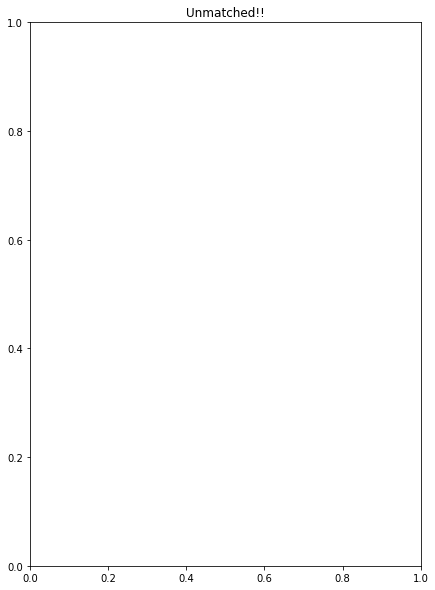

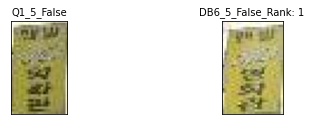

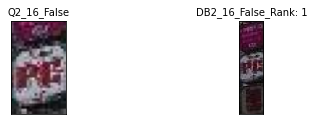

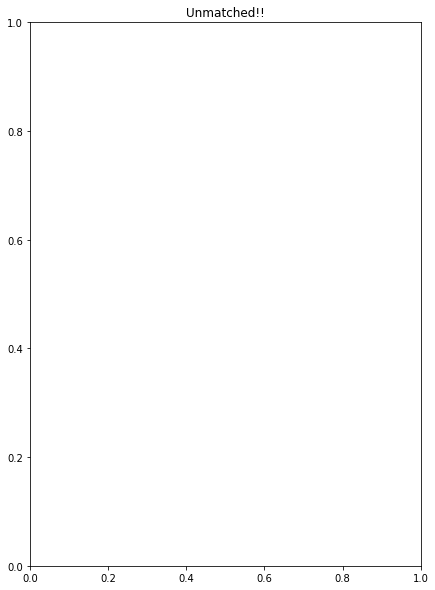

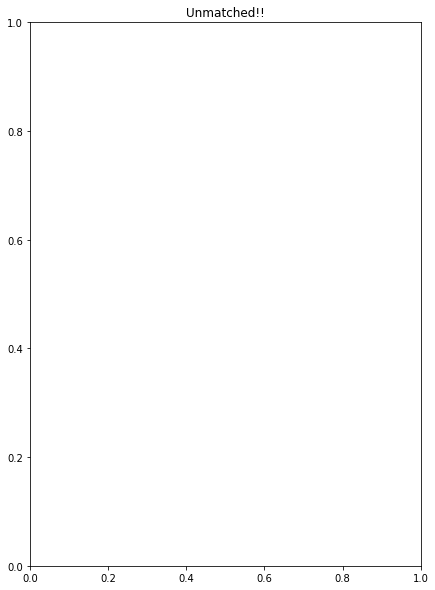

...

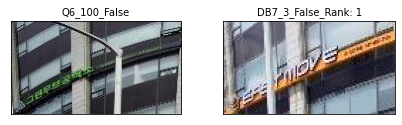

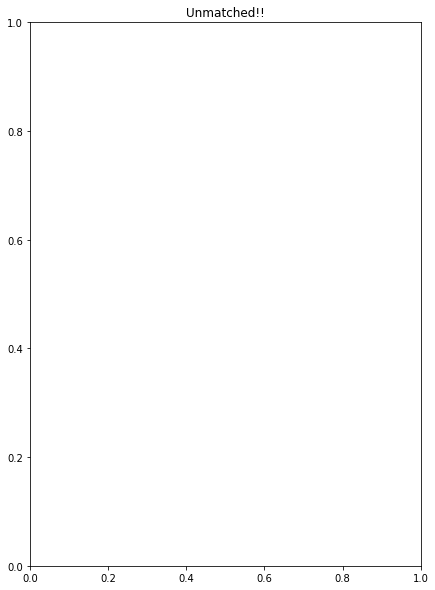

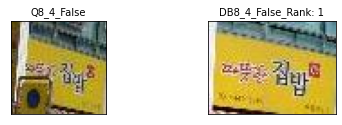

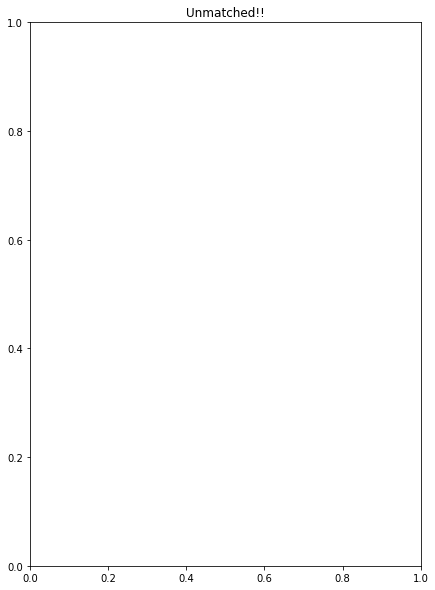

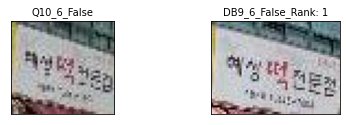

In [60]:
def txt2visualization(panorama_id, q_crop_dir, db_crop_dir, thres_result_topk, save_dir, topk = 1):
    
    ID_list = [] #for all query identification
    
    result_topk = thres_result_topk[panorama_id]

    rows = topk # 몇 등까지 그릴 것인가?
    cols = 2

    for q_name in result_topk.keys():

        query = q_name + '.jpg'
        try:
            db_name = result_topk[q_name][0]
            db = db_name + '.jpg'
        except:
            print('empty')
       

        if len(result_topk[q_name]) == 0: #empty

            fig = plt.figure(figsize=(7,10)) # rows*cols 행렬의 i번째 subplot 생성
            fig.patch.set_facecolor('xkcd:white') # 하얀 바탕으로

            plt.title("Unmatched!!")

            #save figure
            save_path = save_dir + f'/{panorama_id}/Unmatched_{query}'
            os.makedirs(Path(save_path).parent, exist_ok=True)
            plt.savefig(save_path, dpi = 100, bbox_inches='tight')

            pass
        else: #matched

            q_img_path = q_crop_dir + f'/{panorama_id}/{query}'
            db_img_path = db_crop_dir + f'/{panorama_id}/{db}'

            if query not in ID_list: #ID가 처음 나올 때

                #init
                #sketch
                fig = plt.figure(figsize=(7,10)) # rows*cols 행렬의 i번째 subplot 생성
                fig.patch.set_facecolor('xkcd:white') # 하얀 바탕으로

                rank = 0
                r_anchor = 0
                # sav_cnt = 0

            if rank >= topk:
                #for saving memory, close opened figure
                plt.cla()
                plt.clf()
                plt.close('all')
                pass

#                 if sav_cnt == 0: #not yet saved

#                     #save figure
#                     os.makedirs(Path(save_path).parent, exist_ok=True)
#                     plt.savefig(save_path, dpi = 100, bbox_inches='tight')

#                     #show figure - !show() 이후는 새로운 이미지(흰색 빈 이미지)가 저장됩니다.
#                     plt.tight_layout()
#                     plt.show()

#                     #count of save
#                     sav_cnt += 1

#                 else: #1번 저장하고 전부 pass
#                     pass

            else: ##visualization/ topk 결과 이미지만 생성

                if query not in ID_list: #ID가 처음 나올 때

                    #rank
                    rank += 1

                    #for identification
                    ID_list.append(query)

                    #ID query img 왼쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 1)
                    q_name = Path(q_img_path).stem
                    query_img = cv2.imread(q_img_path)
                    ax.imshow(cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"Q{q_name}", fontdict={'fontsize': 10})

                    #1st ID db img 오른쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 2)
                    db_name = Path(db_img_path).stem
                    db_img = cv2.imread(db_img_path)
                    ax.imshow(cv2.cvtColor(db_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"DB{db_name}_Rank: {rank}", fontdict={'fontsize': 10})

                else : #ID가 연달아 나올 때

                    #rank
                    rank += 1

                    # 1칸 아래로 내려서 그리자
                    r_anchor += 1

                    #2st ... db img 오른쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 2+(cols*r_anchor))
                    db_name = Path(db_img_path).stem
                    db_img = cv2.imread(db_img_path)
                    ax.imshow(cv2.cvtColor(db_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"DB{db_name}_Rank: {rank}", fontdict={'fontsize': 10})

                #save figure
                save_path = save_dir + f'/{panorama_id}/Matched_{query}'
                os.makedirs(Path(save_path).parent, exist_ok=True)
                plt.savefig(save_path, dpi = 100, bbox_inches='tight')

#####exec ####
                
q_crop_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/q_crop_val/'
db_crop_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/db_crop_val/'
                
for i, q in enumerate(pnorm_q_dic.keys()):
    
    #process
    print(f"ID : {i}/{len(pnorm_q_dic)}")
    
    # for metric in ["l2"]:
    #     for matcher in ['bf']:
    #         for method in ['rootsift']:
                
                # try: # query ID == db ID
    topk = 5
                # txt_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/pair_txt/kp/' + f'{matcher}/{metric}/{method}/'
    # txt_dir = f'/home/Signboard_Retrieval/roadview_384_crop/match_score/vit_best_pair/'
                # save_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/visualization/' + f'{matcher}/{metric}/{method}/'  
    save_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/visualization/visualization/'
    
    txt2visualization(panorama_id=q, q_crop_dir=q_crop_dir, db_crop_dir=db_crop_dir, \
                      thres_result_topk=thres_result_topk, save_dir=save_dir, topk=topk)
                
                # except: # if query ID not in db ID
                #     print("ID error")
                #     print(f"query ID : {q}")

In [ ]:
# Visualization

def txt2visualization(panorama_id, q_crop_dir, db_crop_dir, txt_dir, save_dir, topk):
    
    ID_list = [] #for all query identification
    txt_path = txt_dir + f"pair_{panorama_id}.txt" # load matching pair txt
    # txt_path = txt_dir + f"pair_{panorama_id}_vit.txt" # only for vit
    
    with open(txt_path, "r") as f:

        rows = topk # 몇 등까지 그릴 것인가?
        cols = 2

        for line in f.readlines():
            data = line.strip().split(',')
            query = data[0] # ex) 110.jpg or 111.png
            db = data[1]

            q_img_path = q_crop_dir + f'/{panorama_id}/{query}'
            db_img_path = db_crop_dir + f'/{panorama_id}/{db}'
            
            if query not in ID_list: #ID가 처음 나올 때

                #init
                #sketch
                fig = plt.figure(figsize=(7,10)) # rows*cols 행렬의 i번째 subplot 생성
                fig.patch.set_facecolor('xkcd:white') # 하얀 바탕으로
                
                rank = 0
                r_anchor = 0
                # sav_cnt = 0

            if rank >= topk:
                #for saving memory, close opened figure
                plt.cla()
                plt.clf()
                plt.close('all')
                pass
            
#                 if sav_cnt == 0: #not yet saved

#                     #save figure
#                     os.makedirs(Path(save_path).parent, exist_ok=True)
#                     plt.savefig(save_path, dpi = 100, bbox_inches='tight')

#                     #show figure - !show() 이후는 새로운 이미지(흰색 빈 이미지)가 저장됩니다.
#                     plt.tight_layout()
#                     plt.show()

#                     #count of save
#                     sav_cnt += 1

#                 else: #1번 저장하고 전부 pass
#                     pass

            else: ##visualization/ topk 결과 이미지만 생성

                if query not in ID_list: #ID가 처음 나올 때

                    #rank
                    rank += 1

                    #for identification
                    ID_list.append(query)

                    #ID query img 왼쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 1)
                    q_name = Path(q_img_path).stem
                    query_img = cv2.imread(q_img_path)
                    ax.imshow(cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"Q{q_name}", fontdict={'fontsize': 10})

                    #1st ID db img 오른쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 2)
                    db_name = Path(db_img_path).stem
                    db_img = cv2.imread(db_img_path)
                    ax.imshow(cv2.cvtColor(db_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"DB{db_name}_Rank: {rank}", fontdict={'fontsize': 10})

                else : #ID가 연달아 나올 때

                    #rank
                    rank += 1

                    # 1칸 아래로 내려서 그리자
                    r_anchor += 1

                    #2st ... db img 오른쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 2+(cols*r_anchor))
                    db_name = Path(db_img_path).stem
                    db_img = cv2.imread(db_img_path)
                    ax.imshow(cv2.cvtColor(db_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"DB{db_name}_Rank: {rank}", fontdict={'fontsize': 10})
                    
                #save figure
                save_path = save_dir + f'/{panorama_id}/top{topk}_{query}'
                os.makedirs(Path(save_path).parent, exist_ok=True)
                plt.savefig(save_path, dpi = 100, bbox_inches='tight')

#####exec ####
                
q_crop_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/q_crop_val/'
db_crop_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/db_crop_val/'
                
for i, q in enumerate(pnorm_q_dic.keys()):
    
    #process
    print(f"ID : {i}/{len(pnorm_q_dic)}")
    
    topk = 5
        
    try: # query ID == db ID
        
        #sift
        # for metric in ["l2"]:
        #     for matcher in ['bf']:
        #         for method in ['rootsift']:

                    
                    # txt_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/pair_txt/kp/' + f'{matcher}/{metric}/{method}/'
                    # save_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/visualization/' + f'{matcher}/{metric}/{method}/'  
        #vit
        txt_dir = f'/home/Signboard_Retrieval/roadview_384_crop/match_score/vit_best_pair/'
        save_dir = '/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/result/visualization/visualization/'

        txt2visualization(panorama_id=q, q_crop_dir=q_crop_dir, db_crop_dir=db_crop_dir, \
                          txt_dir=txt_dir, save_dir=save_dir, topk=topk)
                
    except: # if query ID not in db ID
        print("ID error")
        print(f"query ID : {q}")

## 2. Input : Image(nd.array)

### 2.1 Crop : crop_get
    - Input:
        1. Input_1: Query 파노라마 이미지
        2. Input_2: DB 파노라마 이미지
        3. Input_3: Query 파노라마 이미지 간판 검출 결과(class, x,y,w,h)
        4. Input_4: DB 파노라마 이미지 간판 검출 결과(class, x,y,w,h)
        5. (선택) Input_5: 파노라마 ID
        
        ======
        q_panorama = img
        db_panorama = img
        q_coord_list = [(class, x,y,w,h), ..., (class, x,y,w,h)]
        db_coord_list = [(class, x,y,w,h), ..., (class, x,y,w,h)]

In [12]:
result_path = '/home/Signboard_Retrieval/roadview_384_crop/match_score/'
topk = 1

def crop_get(q_panorama, db_panorama, q_coord_list, db_coord_list, panorama_id=0):
    
    '''
    panorama_id : ID of panorama, specific location identified number including query and database
    '''
    
    #get query cropped image
    q_crop_list = [] #많아봤자 10개 이미지, 작은 크기이므로
    for q_coord in q_coord_list:
        
        # get coord
        _, float_x_center, float_y_center, float_width, float_height = q_coord
        del q_coord
        
        # crop image
        min_x = int(float_x_center - float_width / 2)
        min_y = int(float_y_center - float_height / 2)
        max_x = min_x + int(float_width)
        max_y = min_y + int(float_height)
        del float_x_center, float_y_center, float_width, float_height
        
        #cv2 crop
        croppedImage = q_panorama[min_y: max_y, min_x: max_x]

        # PIL Image crop
        # det_box = (min_x, min_y, max_x, max_y)
        # croppedImage = img_org.crop(det_box)
        
        #get cropped Image
        q_crop_list.append(croppedImage)
        del croppedImage
        
    #get db cropped image
    db_crop_list = [] #많아봤자 10개 이미지, 작은 크기이므로
    for db_coord in db_coord_list:
        
        # get coord
        _, float_x_center, float_y_center, float_width, float_height = db_coord
        del db_coord
        
        # crop image
        min_x = int(float_x_center - float_width / 2)
        min_y = int(float_y_center - float_height / 2)
        max_x = min_x + int(float_width)
        max_y = min_y + int(float_height)
        del float_x_center, float_y_center, float_width, float_height
        
        #cv2 crop
        croppedImage = db_panorama[min_y: max_y, min_x: max_x]

        # PIL Image crop
        # det_box = (min_x, min_y, max_x, max_y)
        # croppedImage = img_org.crop(det_box)
        
        #get cropped Image
        db_crop_list.append(croppedImage)
        del croppedImage
        
    return q_crop_list, db_crop_list, panorama_id

In [15]:
# Input Sample

with open('/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/test/db_coord_list.pkl', 'rb') as fp: #len은 동일
    db_coord_list = pickle.load(fp)
with open('/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/test/q_coord_list.pkl', 'rb') as fp: #len은 동일
    q_coord_list = pickle.load(fp)
with open('/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/test/db_panorama_list.pkl', 'rb') as fp: #len은 동일
    db_panorama_list = pickle.load(fp)
with open('/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/test/q_panorama_list.pkl', 'rb') as fp: #len은 동일
    q_panorama_list = pickle.load(fp)

q_panorama = q_panorama_list[0]
db_panorama = db_panorama_list[0]

#### exec ####

start = time.perf_counter()

q_crop_list, db_crop_list, panorama_id = crop_get(q_panorama, db_panorama, q_coord_list, db_coord_list)

total_time = time.perf_counter()-start

with open('/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/test/'+'db_crop_list'+ ".pkl", 'wb') as fp:
        pickle.dump(db_crop_list, fp, protocol=pickle.HIGHEST_PROTOCOL)
with open('/home/Signboard_Retrieval/roadview_384_crop/panorama_test/panorama_crop/test/'+'q_crop_list'+ ".pkl", 'wb') as fp:
        pickle.dump(q_crop_list, fp, protocol=pickle.HIGHEST_PROTOCOL)        

len(q_coord_list), len(db_coord_list), len(q_crop_list), len(db_crop_list), panorama_id

(9, 8, 9, 8, 0)

### 2.2 Feature Descriptor
    - Only RootSIFT

In [229]:
# RootSIFT
# import the necessary packages

class RootSIFT:
	def __init__(self, max_kps):
		# initialize the SIFT feature extractor
		self.max_kps = max_kps
		self.extractor = cv2.SIFT_create(self.max_kps)
	def compute(self, image, kps, eps=1e-7):
		# compute SIFT descriptors
		kps, descs = self.extractor.detectAndCompute(image,kps)
		# if there are no keypoints or descriptors, return an empty tuple
		if len(kps) == 0:
			return ([], None)
		# apply the Hellinger kernel by first L1-normalizing and taking the
		# square-root(L2-noramlized)
		descs /= (descs.sum(axis=1, keepdims=True) + eps)
		descs = np.sqrt(descs)
		#descs /= (np.linalg.norm(descs, axis=1, ord=2) + eps)
		# return a tuple of the keypoints and descriptors
		return (kps, descs)

In [4]:
# RootSIFT
def rootsift_extractor(img):
    '''
    Description: extract \emph{sift} feature from given image
    Input: file_path - image path
    Output: des - a list of descriptors of all the keypoint from the image
    '''
    gray= cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    rs = RootSIFT(99999) #full
    _, des = rs.compute(gray, None) 

    return des

### 2.3 Retrieval : ret_kp
    - SIFT BF Matching Retrieval

In [17]:
# return q_crop_list, db_crop_list, panorama_id
# crop id는 임의로 부여하면 된다. why? 1쌍씩 들어오기 때문에.

def ret_kp(q_crop_list, db_crop_list, panorama_id, txt_save_path, matcher='bf', metric="l2", \
           val = "union", cross_check=True, img_format='jpg'):
    
    '''
    q_crop_list : list(np.array, ..., np.array), list of query panorama cropped images
    db_crop_list : list(np.array, ..., np.array), list of db panorama cropped images
    panorama_id : ID of panorama, specific location identified number including query and database
    txt_save_path : path of saving matching pair txt file
    ==
    metric : str, how to compare with two key points, ["l1" : "NORM_L1", "l2" : "NORM_L2"]
    matcher : str, how to match key point with query and database, ['bf' : 'BF', 'flann' : 'FlannBased']
    val : str, how to calculate match score, ['union' : intersection / union, 'min' : intersection / min set]
    cross_check : bool, whether both description are all matched
    img_format : str, image format, [jpg, png, ...]
    '''
    
    #info
    print(f"{matcher}-{metric}")
    
    # check time
    start = time.perf_counter()
    
    # config
    matcher_dic = {'bf' : 'BF', 'flann' : 'FlannBased'}
    metric_dic = {"l1" : "NORM_L1", "l2" : "NORM_L2"}
    if matcher == 'bf':
        match = eval(f"cv2.BFMatcher(cv2.{metric_dic[metric]}, crossCheck={cross_check})") #cross_check 양쪽 des 매칭된 kp만 반영 ↔ 속도
    else: #flann
        FLANN_INDEX_KDTREE = 1
        index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
        search_params = dict(checks=50)
        match = eval(f"cv2.FlannBasedMatcher({index_params}, {search_params})")
        
    result_dic = {}
    
    for q_idx, q_image in enumerate(q_crop_list):
        
        #extract feature
        # try:
        des_q = rootsift_extractor(q_image) 
        # except:
        #     print("extract q feature error")
    
        #q -> db match list
        match_list = []

        for db_idx, db_image in enumerate(db_crop_list):

            #extract feature
            #match btw query and db
            try:
                des_db = rootsift_extractor(db_image) 
                matches = match.match(des_q, des_db)
                
                #####eval#####
                # 매칭된 개수
                inter = len(matches)
                if val == 'union':
                    # 교집합/ 합집합    
                    union = (len(des_q)+len(des_db))
                    match_score = inter / union
                else :  # 'min'
                    # 교집합/ 작은 집합 수
                    min_set = min(len(des_q), len(des_db))
                    match_score = inter / min_set

                match_list.append((db_idx, match_score))
            except:
                print("extract db feature error")

        #query db matching dic
        result_dic[q_idx] = match_list
    
    #ret time per panorama
    print("ret_time", time.perf_counter()-start)
    
    # save match pair .txt
    os.makedirs(txt_save_path, exist_ok=True)
    out_file = txt_save_path + f"/pair_{panorama_id}_sift" + ".txt"
    f_out = open(out_file, 'w')

    for q_idx in list(result_dic.keys()):
        
        # sort by match score(union)
        rank_list = sorted(result_dic[q_idx], key = lambda x: -x[1])
        
        for (db_idx, _)  in rank_list:    
            
            f_out.write(str(q_idx) + f'.{img_format},' + str(db_idx) + f'.{img_format}' + '\n')
            f_out.flush()
    f_out.close()

##### exec ######
txt_save_path = '/home/Signboard_Retrieval/roadview_384_crop/match_score/sift_best_pair/'

# check time
start = time.perf_counter()

# try:
# retrieval by keypoint matching
ret_kp(q_crop_list=q_crop_list, db_crop_list=db_crop_list, panorama_id=panorama_id, txt_save_path=txt_save_path)

# except: # if query ID not in db ID
#     print("ID error")
#     print(f"query ID : {q}")
                    
#check time
print("total_time", time.perf_counter()-start)

# total_time 49.52079527702881

bf-l2
ret_time 0.10497300798306242
total_time 0.10636653599794954


### 2.4 Merge : merge_topk
    - Merge SIFT& VIT 
        1. SIFT+KNN-Matching Score(K=2) : match_score
    - Sort& Filter by topk

In [28]:
#input : image
def match_score(q_image, db_image):
    # Trace how to get the match score
    q_img_gray = cv2.cvtColor(q_image, cv2.COLOR_BGR2GRAY)
    q_img_flip0 = cv2.flip(q_img_gray, 0) #상하 반전
    q_img_flip1 = cv2.flip(q_img_gray, 1) #좌우 반전

    db_img_gray = cv2.cvtColor(db_image, cv2.COLOR_BGR2GRAY)
    
    # SIFT feature
    sift = cv2.SIFT_create()
    kp_q, des_q = sift.detectAndCompute(q_img_gray,None)
    kp_q0, des_q0 = sift.detectAndCompute(q_img_flip0,None)
    kp_q1, des_q1 = sift.detectAndCompute(q_img_flip1,None)
    kp_db, des_db = sift.detectAndCompute(db_img_gray,None)
    
    # KNN(K=2) Match including flipped img
    bf = cv2.BFMatcher(cv2.NORM_L2) #전수조사, Normalized L2

    match_num_list = []

    for des_q in [des_q, des_q0, des_q1]:
        matches = bf.knnMatch(des_q, des_db, k=2) #KNN-Matching(K=2) for match_score

        # ratio_threshold
        good_without_list = []

        cnt = 0
        for m,n in matches:
            cnt += 1
            if m.distance < (1.2/1.8)*n.distance: #2nd 최근접 이웃 거리의 특정 비율 보다 작은 1st 최근접 이웃만!

                good_without_list.append(m)

        #get match_num
        match_num_list.append(len(good_without_list))

    return max(match_num_list)

In [32]:
def merge_topk(result_path, q_crop_list, db_crop_list, panorama_id, topk, algo='max', val=False, save=False):
    
    '''
    topk: int, the number of matching candidates
    match_weight: float, threshold of whether matched or not
    result_path: str, folder path saving results, './match_score/'
    method: str, what you want to use, ['vit', 'sift', 'vit_sift', 'sift_vit']
    algo: str, matching algorithm, ['max', 'erase']
        - 'max' : matching pairs for maximizing score
        - 'erase' : matching pairs removing top1 prediction sequentially.
    val: bool, whether evaluate or not
    '''

    #merge
    method = ['sift', 'vit', 'ocr']
    merge_dict = {}
    
    for m in method:
        try:
            with open(f"{result_path}/{m}_best_pair/pair_{panorama_id}_{m}.txt", "r") as f:
                for line in f.readlines():
                    data = line.strip().split(',')
                    q_idx = data[0].split('.')[0]
                    db_idx = data[1].split('.')[0]
                    score = match_score(q_image=q_crop_list[int(q_idx)], db_image=db_crop_list[int(db_idx)])
                    if q_idx+'-'+db_idx not in merge_dict: #3가지 방법에서 특정 q_db pair가 중복된다면, 점수를 합산!
                        merge_dict[q_idx+'-'+db_idx] = score
                    else:
                        merge_dict[q_idx+'-'+db_idx] += score
        except:
            print(f"method {m} error")
            
    #change form
    result_dict = {}
    
    for key in merge_dict:
        imgs = key.split('-')
        q = imgs[0]
        db = imgs[1]
        del imgs
        score = merge_dict[key]
        
        #특정 query에 대해, 모든 ref를 list에 모아주기
        if q not in result_dict: #이 query가 처음 나왔을 때
            result_dict[q] = [(db, int(score))]
        else: #query가 중복될 경우
            db_list = result_dict[q]
            db_list.append((db, int(score)))
            result_dict[q] = db_list
            
    #Matching Algorithm
    if algo == 'max':
    
        result_topk = {}

        for q in result_dict.keys():

            #use match score sorted
            topk_list = sorted(result_dict[q], key=lambda x: -x[1])[:topk] #(db, score)
            result_topk[q] = topk_list
            
    else: #algo == 'erase'
        result_topk = {}
        erase_list = []

        for q in result_dict.keys():

            #erase top1 matching
            erased_list = [(db, score) for (db, score) in result_dict[q] if db not in erase_list]

            if len(erased_list) != 0: #not empty
                #use match score sorted
                topk_list = sorted(erased_list, key=lambda x: -x[1])[:topk] #(db, score)
                result_topk[q] = topk_list

                #add erased top1 matched db, not score
                erase_list.append(topk_list[0][0])
            else: #empty -> score maximization
                topk_list = sorted(result_dict[q], key=lambda x: -x[1])[:topk] #(db, score)
                result_topk[q] = topk_list
    
    
    ##############################(optional) save& val###########
    
    #save result dict
    if save:
        os.makedirs(result_path+'/final_best_pair/', exist_ok=True)
        with open(result_path+'/final_best_pair/' + f"pair_{panorama_id}_top{topk}_final" + ".pkl", 'wb') as fp:
            pickle.dump(result_topk, fp, protocol=pickle.HIGHEST_PROTOCOL)
    
    #eval mAP@topk
    #ex) query_name : '0_100_False'/ db_name : '2_100_False'
    if val:
        ap = 0
        for q_name in list(result_topk.keys()):
            #query_label
            q_lbl = int(q_name.split('_')[1])

            for rank, db_name in enumerate(result_topk[q_name]):
                #db_label
                db_lbl = int(db_name.split('_')[1])

                if (q_lbl == db_lbl) & (q_lbl != 100): #& ('True' not in q_name) : ##Count #100 not matched / + except change
                    ap += 1
        ap/=len([q for q in result_topk.keys() if ('100' not in q)]) #& ('True' not in q)]) ##Divide #except unmatched '100' / + except change
        print(f"AP@{topk} is {ap}") #result_topk 자체가 filter
        
        return result_topk, ap
    
    return result_topk

# check time
start = time.perf_counter()

##### exec ######

#맨 위에 선언해야 한다.
# result_path = '/home/Signboard_Retrieval/roadview_384_crop/match_score/' 
# topk = 5

# return q_crop_list, db_crop_list, panorama_id
    
# try: # panorama id가 있을 때
result_topk = merge_topk(result_path=result_path, q_crop_list=q_crop_list, db_crop_list=db_crop_list, \
                             panorama_id=panorama_id, topk=topk, val=False, save=False)

print(result_topk)

# except: # panorama id가 없을 때
#     print(f"panorama_id {panorama_id} error")


# total_time 57.5849611699814

# except changed
# total mAP@1 : 0.6119146005509642
# total mAP@5 : 0.8918732782369146

# include changed
# total mAP@1 : 0.6116179275270185
# total mAP@5 : 0.8817016317016317

method vit error
method ocr error
{'0': ['4', '0', '2', '6', '1'], '1': ['6', '4', '1', '2', '7'], '2': ['0', '3', '6', '2', '5'], '3': ['6', '5', '3', '0', '4'], '4': ['6', '1', '0', '2', '3'], '5': ['1', '0', '5', '6', '4'], '6': ['1', '5', '2', '4', '6'], '7': ['6', '3', '0', '1', '2'], '8': ['7', '1', '4', '6', '2']}


### - Visualization

In [48]:
# input image
def txt2visualization(panorama_id, q_crop_list, db_crop_list, txt_path, save_dir, topk):
    
    qid_list = [] #for all query identification
    
    with open(txt_path, "r") as f:

        rows = topk # 몇 등까지 그릴 것인가?
        cols = 2

        for line in f.readlines():
            data = line.strip().split(',')
            q_idx = int(data[0].split('.')[0]) # index
            db_idx = int(data[1].split('.')[0])
            
            if q_idx not in qid_list: #ID가 처음 나올 때

                #init
                #sketch
                fig = plt.figure(figsize=(7,10)) # rows*cols 행렬의 i번째 subplot 생성
                fig.patch.set_facecolor('xkcd:white') # 하얀 바탕으로
                
                rank = 0
                r_anchor = 0
                # sav_cnt = 0

            if rank+1 <= topk: #rank 0기준
                
                if q_idx not in qid_list: #ID가 처음 나올 때

                    #rank
                    rank += 1

                    #for identification
                    qid_list.append(q_idx)

                    #ID query img 왼쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 1)
                    query_img = q_crop_list[q_idx]
                    ax.imshow(cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"Q{q_idx}", fontdict={'fontsize': 10})

                    #1st ID db img 오른쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 2)
                    db_img = db_crop_list[db_idx]
                    ax.imshow(cv2.cvtColor(db_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"DB{db_idx}_Rank: {rank}", fontdict={'fontsize': 10})

                else : #ID가 연달아 나올 때

                    #rank
                    rank += 1

                    # 1칸 아래로 내려서 그리자
                    r_anchor += 1

                    #2st ... db img 오른쪽 열에 그리기
                    ax = fig.add_subplot(rows, cols, 2+(cols*r_anchor))
                    db_img = db_crop_list[db_idx]
                    ax.imshow(cv2.cvtColor(db_img, cv2.COLOR_BGR2RGB))
                    ax.set_xticks([]), ax.set_yticks([])
                    ax.set_title(f"DB{db_idx}_Rank: {rank}", fontdict={'fontsize': 10})
                    
                #save figure
                save_path = save_dir + f'/{panorama_id}/top{topk}_{q_idx}.jpg'
                os.makedirs(Path(save_path).parent, exist_ok=True)
                plt.savefig(save_path, dpi = 100, bbox_inches='tight')

            else: ##visualization/ topk 결과 이미지만 생성
                
                #for saving memory, close opened figure
                plt.cla()
                plt.clf()
                plt.close('all')
                pass
            
#                 if sav_cnt == 0: #not yet saved

#                     #save figure
#                     os.makedirs(Path(save_path).parent, exist_ok=True)
#                     plt.savefig(save_path, dpi = 100, bbox_inches='tight')

#                     #show figure - !show() 이후는 새로운 이미지(흰색 빈 이미지)가 저장됩니다.
#                     plt.tight_layout()
#                     plt.show()

#                     #count of save
#                     sav_cnt += 1

#                 else: #1번 저장하고 전부 pass
#                     pass
    print('visualization done')
#####exec ####
                
txt_path='/home/Signboard_Retrieval/roadview_384_crop/match_score/sift_best_pair/pair_0_sift.txt'
save_dir = '/home/Signboard_Retrieval/roadview_384_crop/match_score/visualization/'
topk = 5

txt2visualization(panorama_id=panorama_id, q_crop_list=q_crop_list, db_crop_list=db_crop_list, \
                  txt_path=txt_path, save_dir=save_dir, topk=topk)

visualization done


## 3. Result& Analysis
    - SIFT + BF -> SIFT + VLAD 변경한 이유

    성능이 하락하는 이유: merge를 위한 척도인 match_score를 SIFT+KNN_Matching으로 사용하는 데에서 발생
                        -> 해결책 1. SIFT 대신 super point나, LoFTR로 변경
                        -> 해결책 2. cosine_similarity로 척도를 변경 (L2는 cosine_similarity와 같이 -1~1가 아님.)
    ===============

    <sift>
    threshold = 1
    recall@1:0.24
    precision@1:0.52

    <sift+vit> : thres가 1보다 작으면, sift랑 섞이게 돼서 성능이 하락함을 확인할 수 있음.
    threshold = 1.6/1.8
    recall@1:0.19
    precision@1:0.41

    threshold = 1 -> vit 단독과 같음.
    recall@1:0.33
    precision@1:0.60

    <vit 단독>
    threshold = 1
    recall@1:0.33
    precision@1:0.60